<a href="https://colab.research.google.com/github/shaina-12/Artificial-Intelligence/blob/main/Image%20Processing%20and%20Computer%20Vision/Codes/More_on_Image_Processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### <font style="color:black">Chapter 2</font>
# <font style="color:black">More on Image Processing</font>
This chapter deals with more concepts of Digital Image Processing using Python 3.8.13. I hope you will like it.
## <font style="color:black">Contents:</font>
* Image Transformation
* Intensity Transformation Operations on Images
* Filtering Images
* Image Alignment
* Panoramas 
* High Dynamic Range (HDR) Imaging

## 1. Image Transformation

An image is obtained in spatial coordinates (x, y) or (x, y, z). There are many advantages if the spatial domain image is transformed into another domain. In which solution of any problem can be found easily.

Following are two types of transformations:

1. Fourier Transform
2. Discrete Cosine Transform

### 1.1 Fourier Transformation

Fourier transform is mainly used for image processing. In the Fourier transform, the intensity of the image is transformed into frequency variation and then to the frequency domain. It is used for slow varying intensity images such as the background of a passport size photo can be represented as low-frequency components and the edges can be represented as high-frequency components. Low-frequency components can be removed using filters of FT domain. When an image is filtered in the FT domain, it contains only the edges of the image. And if we do inverse FT domain to spatial domain then also an image contains only edges. Fourier transform is the simplest technique in which edges of the image can be fined.

#### Two Dimensional Fourier Transform

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation.png width="400" height="400"></img>

#### Matrix Notation:

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation2.png width="400" height="400"></img>

#### Properties of Fourier Transformation are as follows:
1. Symmetric Unitary
2.  Periodic Extension
3. Sampled Fourier
4. Fast
5. Conjugate Symmetry
6. Circular Convolution

#### Example:

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation3.png width="400" height="400"></img>

#### Example of Blurred Image and its Fourier Transformation

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation4.png width="400" height="400"></img>

### <i>Demonstration</i>
For More Information Please Visit The Given Links: 

https://opencv24-python-tutorials.readthedocs.io/en/stable/py_tutorials/py_imgproc/py_transforms/py_fourier_transform/py_fourier_transform.html

https://medium.com/crossml/fourier-transformation-in-image-processing-84142263d734

https://homepages.inf.ed.ac.uk/rbf/HIPR2/fourier.htm#:~:text=The%20Fourier%20Transform%20is%20an,is%20the%20spatial%20domain%20equivalent.

https://www.analyticsvidhya.com/blog/2021/05/computer-vision-using-opencv-with-practical-examples/

In [ ]:
# Importing Necessary Packages
import numpy as np
import matplotlib.pyplot as plt
from skimage import img_as_ubyte
from scipy import ndimage
import cv2

In [ ]:
# Defining Fuction for Displaying Images and The Histogram
def plot_image(image,title,cmaps):
    plt.title(title,size=20)
    plt.imshow(image,cmap=cmaps)
    plt.axis('off')
def plot_imageRGB(image,title):
    plt.title(title,size=20)
    plt.imshow(image)
    plt.axis('off')
def plot_histRGB(r,g,b,title):
    r, g, b = img_as_ubyte(r), img_as_ubyte(g), img_as_ubyte(b)
    plt.hist(np.array(r).ravel(), bins=256, range=(0, 256), color='r', alpha=0.5)
    plt.hist(np.array(g).ravel(), bins=256, range=(0, 256), color='g', alpha=0.5)
    plt.hist(np.array(b).ravel(), bins=256, range=(0, 256), color='b', alpha=0.5)
    plt.xlabel('pixel value', size=20), plt.ylabel('frequency', size=20)
    plt.title(title, size=20)
def plot_histGrayScale(gray,title):
    histogram = cv2.calcHist([gray],[0],None,[256],[0, 256])
    #print(histogram)
    plt.bar(np.arange(0,256),histogram.reshape(-1),color='black',width=1)
    plt.xlabel('pixel value', size=20), plt.ylabel('frequency', size=20)
    plt.title(title, size=20)

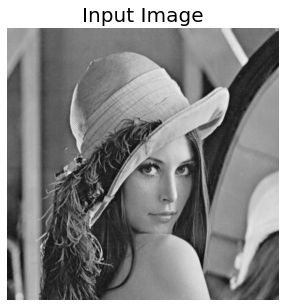

In [ ]:
# Reading and Displaying Grayscale Image
im = cv2.imread("L.png",0)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(im,'Input Image','gray')
plt.show()

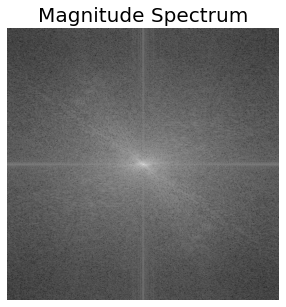

In [ ]:
# Apply Discrete Fourier Transform on the Image and Display the Resutant Image and its Histogram
dft = cv2.dft(np.float32(im),flags=cv2.DFT_COMPLEX_OUTPUT)
dft_shift = np.fft.fftshift(dft)
magnitude_spectrum = 20*np.log(cv2.magnitude(dft_shift[:,:,0],dft_shift[:,:,1]))
dft_img = cv2.magnitude(dft_shift[:,:,0],dft_shift[:,:,1])
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(magnitude_spectrum,'Magnitude Spectrum','gray')
plt.show()

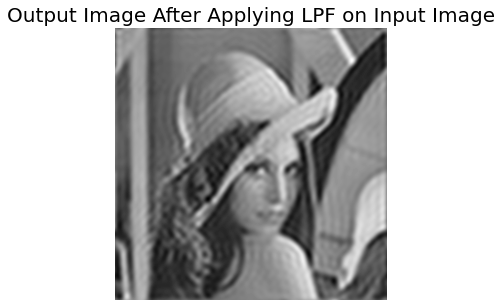

In [ ]:
# Performing IDFT or Low Pass Filtering on Images
rows, cols = im.shape
crow,ccol = rows//2 , cols//2
# create a mask first, center square is 1, remaining all zeros
mask = np.zeros((rows,cols,2),np.uint8)
mask[crow-30:crow+30, ccol-30:ccol+30] = 1
# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_back = cv2.idft(f_ishift)
img_back = cv2.magnitude(img_back[:,:,0],img_back[:,:,1])
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(img_back,'Output Image After Applying LPF on Input Image','gray')
plt.show()

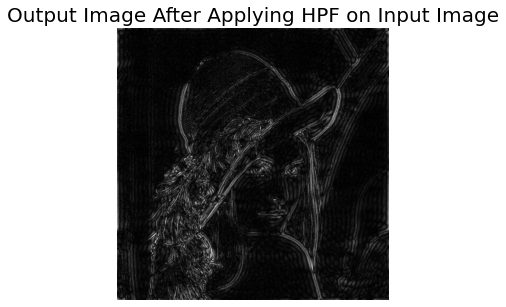

In [ ]:
# Performing IDFT or High Pass Filtering on Images
rows, cols = im.shape
crow,ccol = rows//2 , cols//2
# create a mask first, center square is 1, remaining all zeros
mask = np.ones((rows,cols,2),np.uint8)
mask[crow-30:crow+30, ccol-30:ccol+30] = 0
# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_back = cv2.idft(f_ishift)
img_back = cv2.magnitude(img_back[:,:,0],img_back[:,:,1])
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(img_back,'Output Image After Applying HPF on Input Image','gray')
plt.show()

### 1.2 Discrete Cosine Transformation (DCT)

In Discrete Cosine Transformation, coefficients carry information about the pixels of the image. Also, much information is contained using very few coefficients, and the remaining coefficient contains minimal information. These coefficients can be removed without losing information. By doing this, the file size is reduced in the DCT domain. DCT is used for lossy compression.

#### One Dimension Discrete Cosine Transformation:

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation5.png width="400" height="400"></img>

#### Two Dimension Discrete Cosine Transformations:

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation6.png width="400" height="400"></img>

#### Properties of Discrete cosine transformation are as following:
1. Real and Orthogonal: C=C* → C-1=CT
2. Not! Real part of DFT
3. Fast Transform
4. Excellent Energy Compaction (Highly Correlated Data)

#### Example:

<img src=https://static.javatpoint.com/tutorial/dip/images/image-transformation7.png width="400" height="400"></img>

#### More Information about DCT:

<img src=https://miro.medium.com/max/1400/1*byq6TXRBNSp3gYtQYXlkrA.png width="1000" height="1000"></img>

### <i>Demonstration</i>
For More Information Please Visit The Given Links: 

https://github.com/ojaashampiholi/DCT_Analysis

https://towardsdatascience.com/image-compression-dct-method-f2bb79419587

https://docs.opencv.org/2.4/modules/core/doc/operations_on_arrays.html

https://docs.scipy.org/doc/scipy-0.14.0/reference/generated/scipy.fftpack.dct.html#scipy.fftpack.dct

https://medium.com/@fanzongshaoxing/accelerate-opencv-dct-discrete-cosine-transform-in-multi-dimensional-array-2225acf89eb4

https://www.kaggle.com/code/siddheshmahajan/image-processing-image-compression-using-dct/notebook

In [ ]:
# Defining Quantization Matrix
# The (8*8) Quantization Matrix which is predefined here is the standard
# matrix that is used in JPEG Compression.
# This function calculates the Quantization Matrix depending on the 
# percentage of compressed image size required.
# If the desired percentage is 90%, more information is retained and the 
# compression ratio turns out to be less.
# If the desired percentage is 10%, more compression takes place at the
# cost of loss of information.
# 50% is the Standard value that is chosen for JPEG compression, hence same 
# value has been used here.
def getQuantizationMatrix(requiredQualityLevel = 50):
    Q = np.array([[16,11,10,16,24,40,51,61],
                  [12,12,14,19,26,58,60,55],
                  [14,13,16,24,40,57,69,56],
                  [14,17,22,29,51,87,80,62],
                  [18,22,37,56,68,109,103,77],
                  [24,35,55,64,81,104,113,92],
                  [49,64,78,87,103,121,120,101],
                  [72,92,95,98,112,100,103,99]])
    if requiredQualityLevel == 50:
        return Q
    elif requiredQualityLevel>50:
        Q = (Q * ((100-requiredQualityLevel)/50)).astype('int')
        Q = np.where(Q>255,255,Q)
        return Q
    else:
        Q = (Q * (50/requiredQualityLevel)).astype('int')
        Q = np.where(Q>255,255,Q)
        return Q

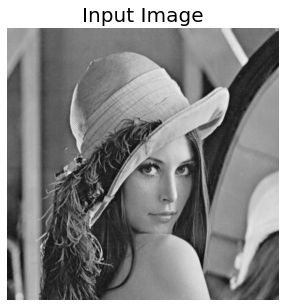

In [ ]:
# Reading and Displaying Grayscale Image 
img = cv2.imread("L.png",0)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(img,'Input Image','gray')
plt.show()

In [ ]:
import itertools
N = 8
compressionPercentage = 50
h,w = img.shape
# Split the image into several blocks where 8*8 is the size of eack block
imgBlocks = [np.float32(img[j:j+8,i:i+8])-128 for (j,i) in itertools.product(range(0,h,8),range(0,w,8))]
# DCT is performed on the image block
dctBlocks = [cv2.dct(ib) for ib in imgBlocks]
# Quantization is performed on the transformed image block
quantBlocks = [dbk/getQuantizationMatrix() for dbk in dctBlocks]
# IDCT is performed on the quantized image block
idctBlocks = [cv2.idct(qbk) for qbk in quantBlocks]
# Stiching inversely transformed image blocks back to the image
row = 0
rowNcol = []
for j in range(int(w/N),len(idctBlocks)+1,int(w/N)):
    rowNcol.append(np.hstack((idctBlocks[row:j])))
    row = j
res = np.vstack((rowNcol))

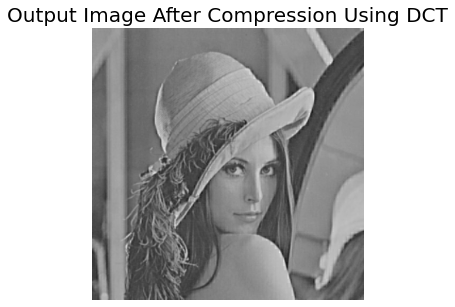

In [ ]:
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plot_image(res,'Output Image After Compression Using DCT','gray')
plt.show()

### 1.3 Applications of Image Transforms

1. Fourier Transform is used for Edge Detection.
2. Discrete Cosine Transform is used for Image Compression.

## 2. Intensity Transformation Operations on Images

Intensity transformations are applied on images for contrast manipulation or image thresholding. These are in the spatial domain, i.e. they are performed directly on the pixels of the image at hand, as opposed to being performed on the Fourier transform of the image.

The following are commonly used intensity transformations:
1. Image Negatives (Linear)
2. Log Transformations
3. Power-Law (Gamma) Transformations
4. Piecewise-Linear Transformation Functions

<img src=https://media.geeksforgeeks.org/wp-content/uploads/20190721174818/log-transformation.png width="400" height="400"></img>

<b>Spatial Domain Processes:</b>
Spatial domain processes can be described using the equation: g(x, y) = T[f(x, y)] where f(x, y) is the input image, T is an operator on f defined over a neighbourhood of the point (x, y), and g(x, y) is the output.

<img src=https://media.geeksforgeeks.org/wp-content/uploads/20190721123041/spatial_domain.png width="400" height="400"></img>

### 2.1 Image Negatives (Linear Transform)

Mathematically, assume that an image goes from intensity levels 0 to (L-1). Generally, L = 256. Then, the negative transformation can be described by the expression s = L-1-r where r is the initial intensity level and s is the final intensity level of a pixel. This produces a photographic negative.

### <i>Demonstration:</i>
For More Information Please Visit The Given Links:

https://www.geeksforgeeks.org/python-intensity-transformation-operations-on-images/

https://www.geeksforgeeks.org/c-program-to-invert-making-negative-an-image-content-in-pgm-format/

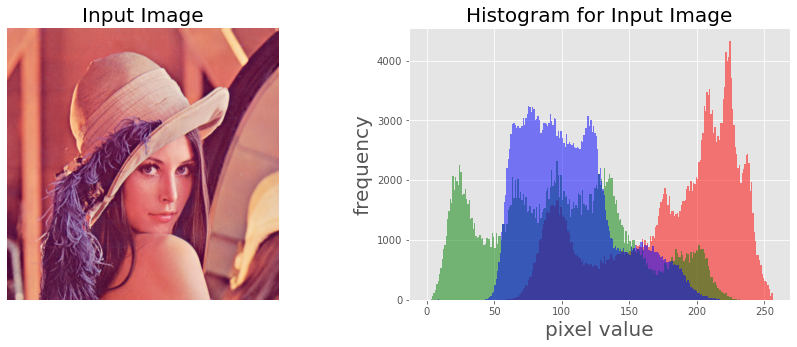

In [ ]:
# Reading and Displaying the Image and Display the Histogram of the Image
im = cv2.imread('Lenna.png')
im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Input Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Input Image')
plt.show()

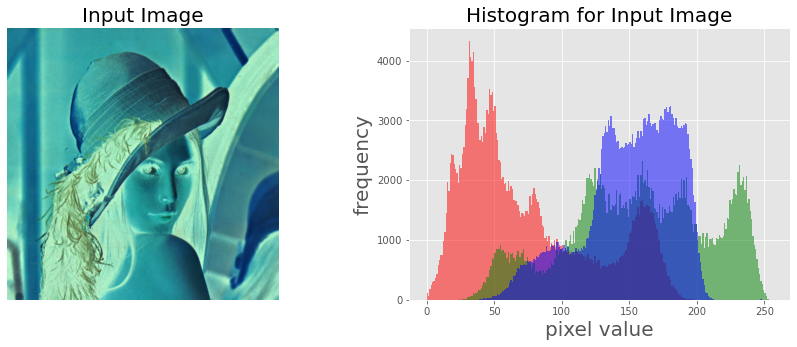

In [ ]:
# Performing Linear Transfrom and Display the Image and Plot its Histogram of the Resultant Image
l, b, h = im.shape
for i in range(l):
    for j in range(b):
        for k in range(h):
            im[i,j,k] = 255-im[i,j,k]
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Input Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Input Image')
plt.show()

### 2.2 Log Transformations:

Mathematically, log transformations can be expressed as s = clog(1+r). Here, s is the output intensity, r>=0 is the input intensity of the pixel, and c is a scaling constant. c is given by 255/(log (1 + m)), where m is the maximum pixel value in the image. It is done to ensure that the final pixel value does not exceed (L-1), or 255. Practically, log transformation maps a narrow range of low-intensity input values to a wide range of output values.

Log transformation is very useful when we need to compress or stretch a certain range of gray-levels in an image. 

### <i>Demonstration:</i>

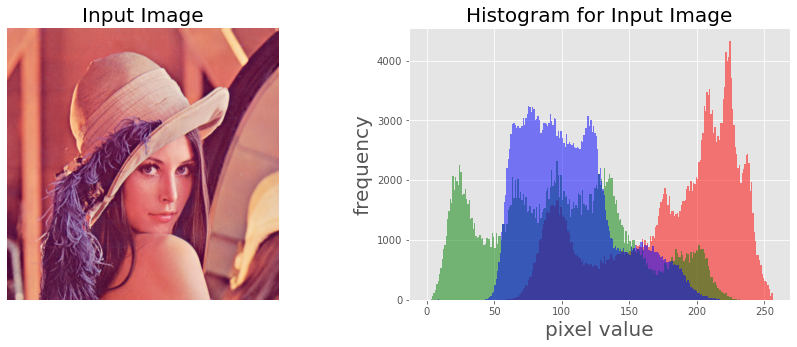

In [ ]:
# Reading and Displaying the Image and Display the Histogram of the Image
im = cv2.imread('Lenna.png')
im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Input Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Input Image')
plt.show()

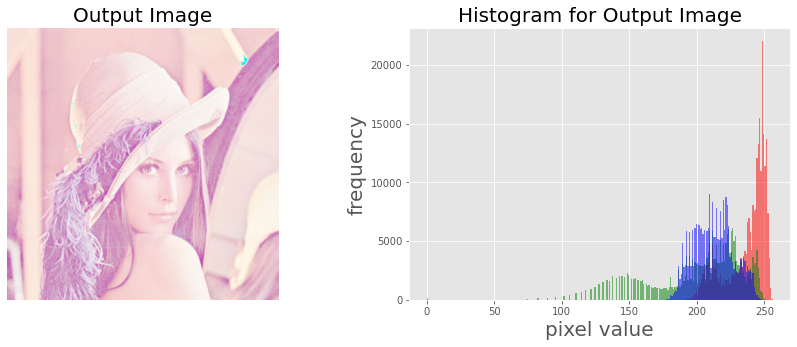

In [ ]:
# Performing Log Transfrom and Display the Image and Plot its Histogram of the Resultant Image
np.seterr(divide = 'ignore')
c = 255/np.log(1+np.max(im))
im=c*np.log(1+im)
im=np.array(im,dtype = np.uint8)
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

### 2.3 Power-Law (Gamma) Transformation:

Power-law (gamma) transformations can be mathematically expressed as: $$s = cr^{\gamma}$$ Gamma correction is important for displaying images on a screen correctly, to prevent bleaching or darkening of images when viewed from different types of monitors with different display settings. This is done because our eyes perceive images in a gamma-shaped curve, whereas cameras capture images in a linear fashion. 

If, gamma>1 (indicated by the curve corresponding to ‘nth power’ label on the graph), the intensity of pixels decreases i.e. the image becomes darker. On the other hand, gamma<1 (indicated by the curve corresponding to 'nth root' label on the graph), the intensity increases i.e. the image becomes lighter.

### <i>Demonstration:</i>

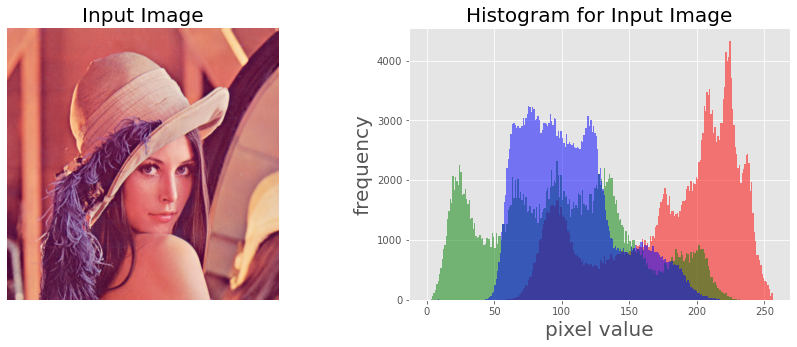

In [ ]:
# Reading and Displaying the Image and Display the Histogram of the Image
im = cv2.imread('Lenna.png')
im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Input Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Input Image')
plt.show()

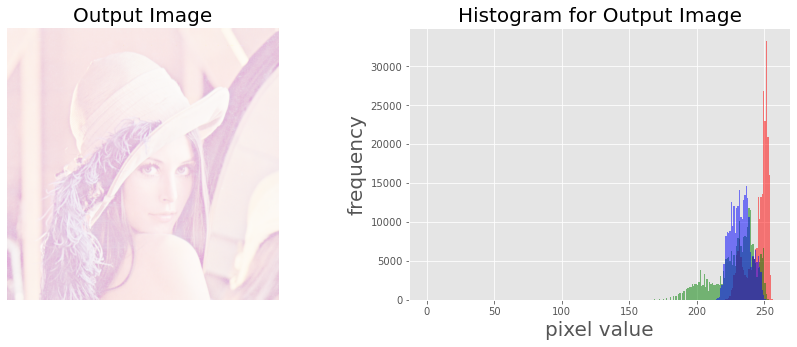

In [ ]:
# Performing Power Log Transfrom and Display the Image and Plot its Histogram of the Resultant Image
# For gamma = 0.1
gamma = 0.1
im1 = np.array(255*(im / 255)**gamma, dtype = 'uint8')
im_r, im_g, im_b = cv2.split(im1)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im1,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

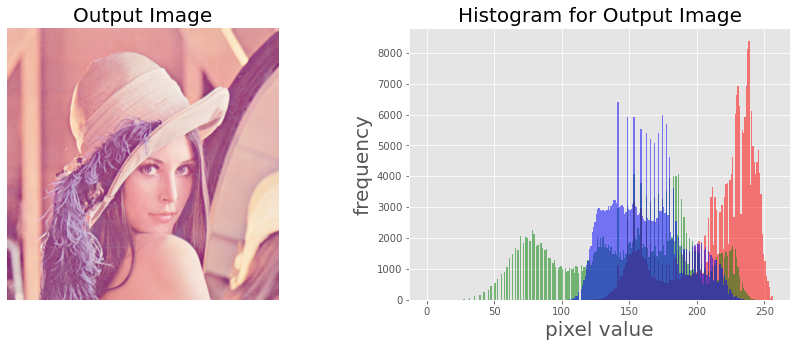

In [ ]:
# For gamma = 0.5
gamma = 0.5
im2 = np.array(255*(im / 255) ** gamma, dtype = 'uint8')
im_r, im_g, im_b = cv2.split(im2)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im2,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

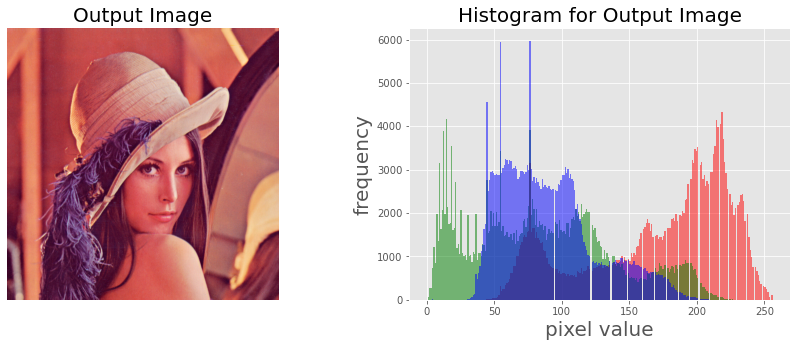

In [ ]:
# For gamma = 1.2
gamma = 1.2
im3 = np.array(255*(im / 255) ** gamma, dtype = 'uint8')
im_r, im_g, im_b = cv2.split(im3)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im3,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

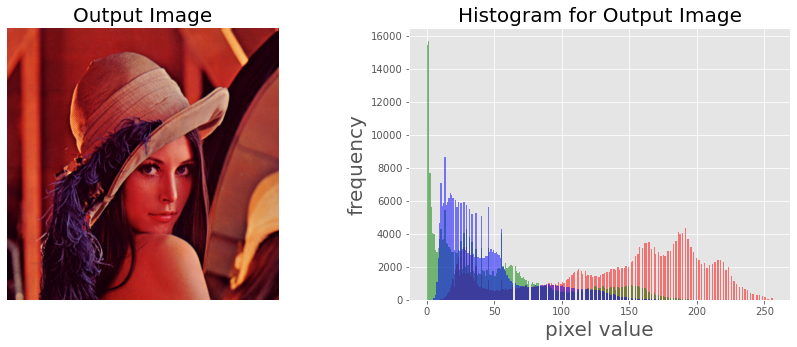

In [ ]:
# For gamma = 2.2
gamma = 2.2
im4 = np.array(255*(im / 255) ** gamma, dtype = 'uint8')
im_r, im_g, im_b = cv2.split(im4)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im4,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

### 2.4 Piecewise-Linear Transformation Functions:

These functions, as the name suggests, are not entirely linear in nature. However, they are linear between certain x-intervals. One of the most commonly used piecewise-linear transformation functions is contrast stretching.

Contrast can be defined as:

Contrast =  (I_max - I_min)/(I_max + I_min)

This process expands the range of intensity levels in an image so that it spans the full intensity of the camera/display. The figure below shows the graph corresponding to the contrast stretching.

<img src=https://media.geeksforgeeks.org/wp-content/uploads/20190722210555/contrast_stretching.png width = 400 height = 400><img>

With (r1, s1), (r2, s2) as parameters, the function stretches the intensity levels by essentially decreasing the intensity of the dark pixels and increasing the intensity of the light pixels. If r1 = s1 = 0 and r2 = s2 = L-1, the function becomes a straight dotted line in the graph (which gives no effect). The function is monotonically increasing so that the order of intensity levels between pixels is preserved.

### <i>Demonstration:</i>

For More Information Please Visit The Given Link:

https://www.geeksforgeeks.org/piece-wise-linear-transformation/

https://stackoverflow.com/questions/45685870/valueerror-images-of-type-float-must-be-between-1-and-1#:~:text=The%20error%20here%20tells%20you%20that%20the%20pixels%27,Converting%20the%20values%20to%20integers%20may%20also%20work.

https://theailearner.com/2019/01/30/contrast-stretching/

In [ ]:
# Function to map each intensity level to output intensity level.
def pixelVal(pix,r1,s1,r2,s2):
    if (0 <= pix and pix <= r1):
        return ((s1 / r1)*pix)/255
    elif (r1 < pix and pix <= r2):
        return (((s2 - s1)/(r2 - r1)) * (pix - r1) + s1)/255
    else:
        return (((255 - s2)/(255 - r2)) * (pix - r2) + s2)/255

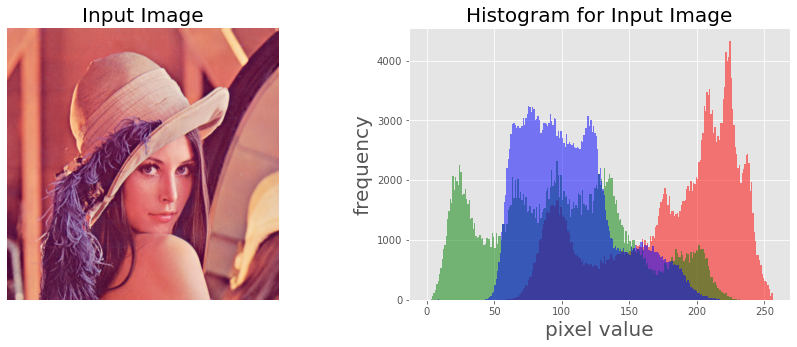

In [ ]:
# Reading and Displaying the Image and Display the Histogram of the Image
im = cv2.imread('Lenna.png')
im = cv2.cvtColor(im,cv2.COLOR_BGR2RGB)
im_r, im_g, im_b = cv2.split(im)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(im,'Input Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Input Image')
plt.show()

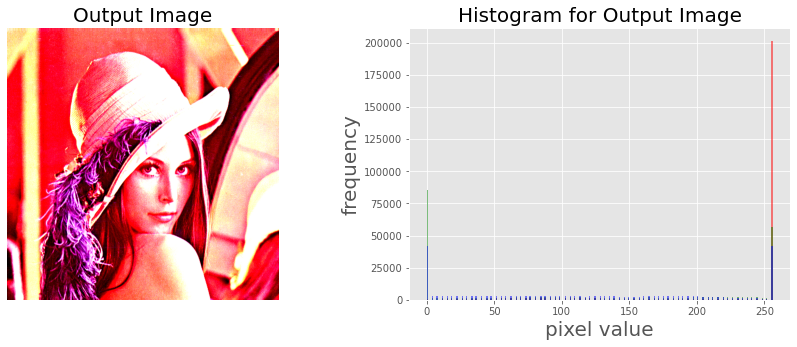

In [ ]:
# Performing Piecewise-Linear Transformation Functions and Display the Image and Plot its Histogram of the Resultant Image
# Define parameters.
r1 = 70
s1 = 0
r2 = 140
s2 = 255
# Vectorize the function to apply it to each value in the Numpy array.
pixelVal_vec = np.vectorize(pixelVal)
# Apply contrast stretching.
contrast_stretched = pixelVal_vec(im, r1, s1, r2, s2)
im_r, im_g, im_b = cv2.split(contrast_stretched)
plt.style.use('ggplot')
plt.figure(figsize=(15,5))
plt.subplot(121), plot_imageRGB(contrast_stretched,'Output Image')
plt.subplot(122), plot_histRGB(im_r, im_g, im_b,'Histogram for Output Image')
plt.show()

## 3. Image Filtering

Image filtering can be used to reduce the noise or enhance the edges of an image. This can help improve the accuracy of machine learning models.

Filtering: Smoothing an image, even out high frequency pixels, detect edges

The following are commonly used image filtering techniques:
1. Averaging or Mean Filtering
2. Meadian Filtering
3. Gaussian Filter
4. Bilateral Filter
5. Image Filtering Using Convolution

### 3.1 Averaging or Mean Filtering

Averaging, or mean filtering, uses a square sliding window to average the values of the pixels. The window is centered over a pixel, then all pixels within the window are summed up and divided by the area of the window (e.g. a 3x3 window will be divided by 9). The larger the window, the blurrier the image. It removes noise and brighten the image but blurs the edges and reduces the spatial resolution

### <i>Demonstration</i>
For More Information Please Visit The Following Links:

https://python.plainenglish.io/image-filtering-and-editing-in-python-with-code-e878d2a4415d

https://stackoverflow.com/questions/22937589/how-to-add-noise-gaussian-salt-and-pepper-etc-to-image-in-python-with-opencv

https://towardsdatascience.com/introduction-of-image-processing-with-python-image-filtering-193e9108ea1d

https://towardsdatascience.com/image-filters-in-python-26ee938e57d2

https://scikit-image.org/skimage-tutorials/lectures/1_image_filters.html

https://www.tutorialspoint.com/python_pillow/python_pillow_adding_filters_to_an_image.htm

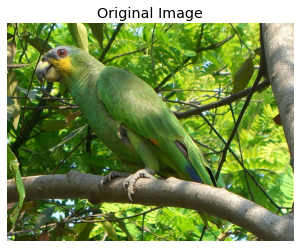

In [ ]:
img = cv2.imread("AmazonParrot.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Fixes color read issue
plt.title('Original Image')
plt.imshow(img)
plt.axis('off')
plt.show()

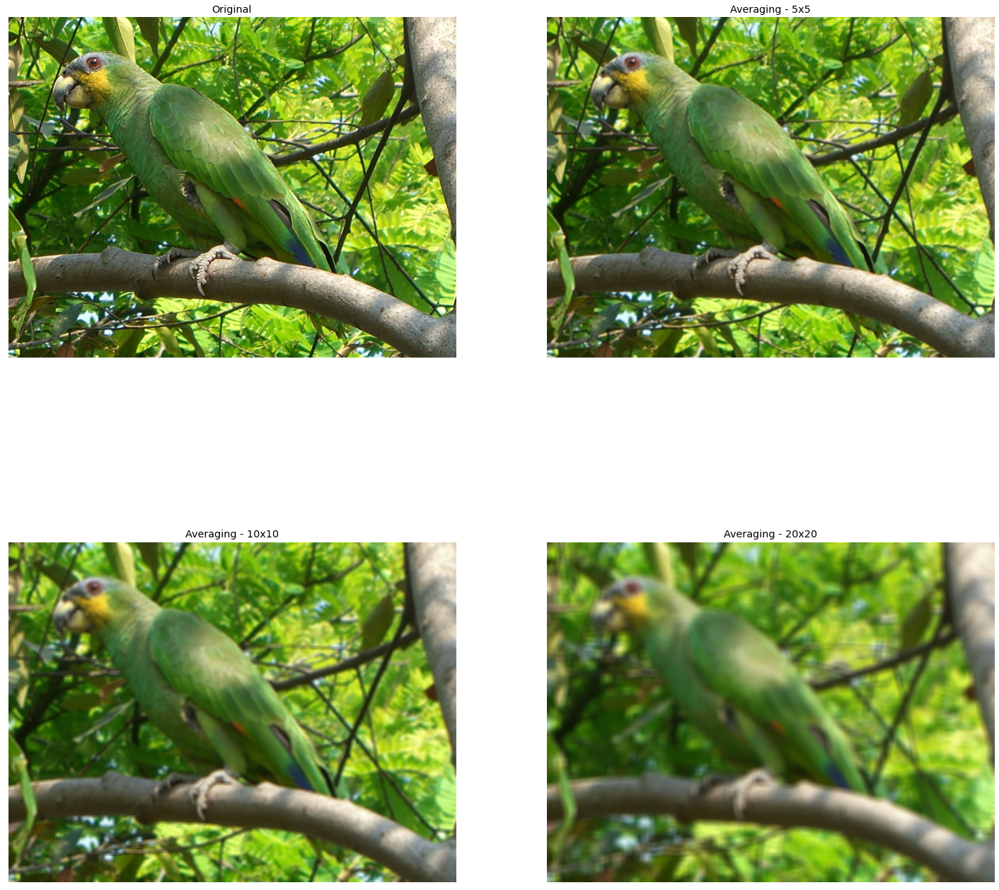

In [ ]:
# applying mean filter
av5 = cv2.blur(img,(5,5))
av10 = cv2.blur(img,(10,10))
av20 = cv2.blur(img,(20,20))
# Plot the image. This code is excluded for the rest of the article.
plt.gcf().set_size_inches(25,25)
plt.subplot(221),plt.imshow(img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(222),plt.imshow(av5),plt.title('Averaging - 5x5')
plt.xticks([]), plt.yticks([])
plt.subplot(223),plt.imshow(av10),plt.title('Averaging - 10x10')
plt.xticks([]), plt.yticks([])
plt.subplot(224),plt.imshow(av20),plt.title('Averaging - 20x20')
plt.xticks([]), plt.yticks([])
plt.show()

### 3.2 Median Filtering

Median filtering is similar to averaging, but the central pixel is replaced with the median value. This kind of filter is good for reducing static or salt and pepper noise in images. One benefit of the median filter is that it retains the edges of an image.

### <i>Demonstration</i>

C:\Users\Shaina Mehta\AppData\Local\Temp\ipykernel_3804\2036672087.py:11: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[coords] = 1
C:\Users\Shaina Mehta\AppData\Local\Temp\ipykernel_3804\2036672087.py:16: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  out[coords] = 0


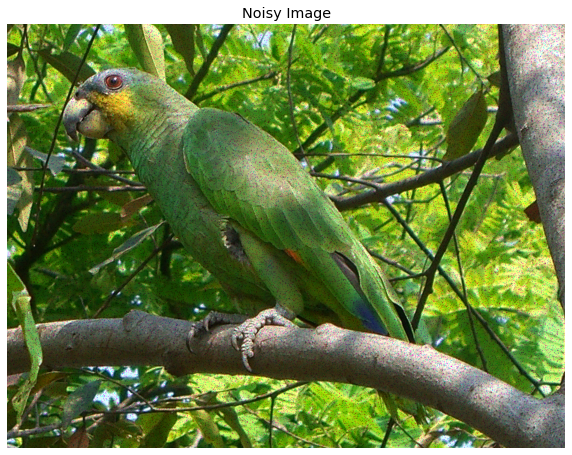

In [ ]:
# lets create a noisy image
def noisy(image):
    row,col,ch = image.shape
    s_vs_p = 0.5
    amount = 0.04
    out = np.copy(image)
    # Salt mode
    num_salt = np.ceil(amount * image.size * s_vs_p)
    coords = [np.random.randint(0, i - 1, int(num_salt))
          for i in image.shape]
    out[coords] = 1
    # Pepper mode
    num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i - 1, int(num_pepper))
          for i in image.shape]
    out[coords] = 0
    return out
noisy_img = noisy(img)
plt.gcf().set_size_inches(10,10)
plt.title('Noisy Image')
plt.imshow(noisy_img)
plt.axis('off')
plt.show()

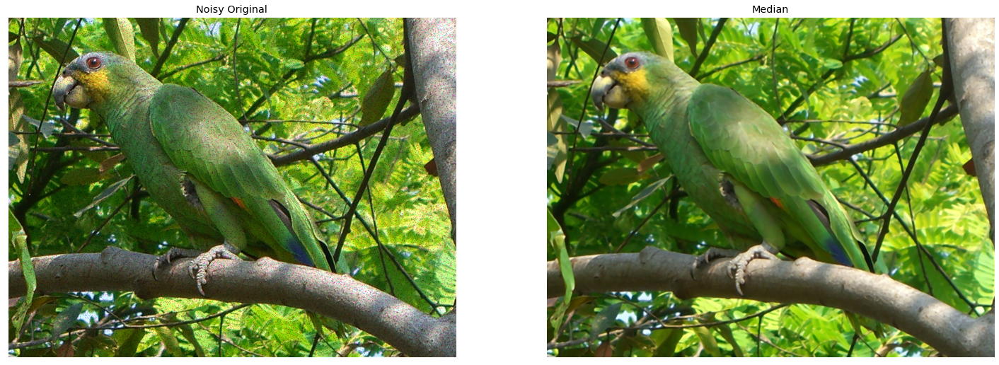

In [ ]:
# applying meadian filter
median = cv2.medianBlur(img,5)
plt.gcf().set_size_inches(25,25)
plt.subplot(121),plt.imshow(noisy_img),plt.title('Noisy Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(median),plt.title('Median')
plt.xticks([]), plt.yticks([])
plt.show()

### 3.3 Gaussian Filter

Gaussian blurring looks at each pixel, then replaces that pixel value with the pixel value times the value drawn from the Gaussian distribution made by the pixels around it. You must specify the standard deviation in the x and y directions. A higher standard deviation leads to more blur.

Gaussian Filter:  blur the image or to reduce noise.

### <i>Demonstration</i>

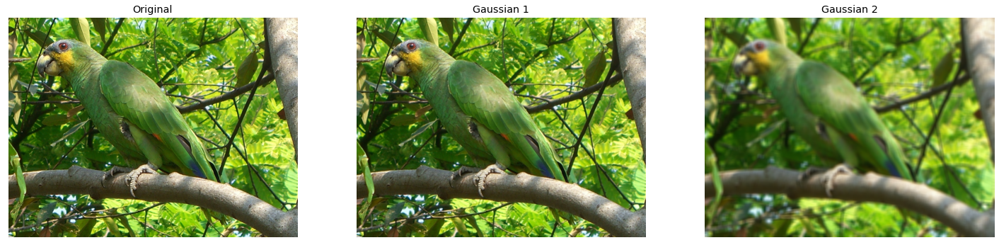

In [ ]:
# applying gaussian filter 
gb1 = cv2.GaussianBlur(img, (3,3), 1,1)
gb2 = cv2.GaussianBlur(img,(15,15),35,35)
plt.gcf().set_size_inches(25,25)
plt.subplot(131),plt.imshow(img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(gb1),plt.title('Gaussian 1')
plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(gb2),plt.title('Gaussian 2')
plt.xticks([]), plt.yticks([])
plt.show()

### 3.4 Bilateral Filter

The bilateral filter is similar to the Gaussian filter, but if pixels are only filtered if they are ‘spatial neighbors’. That is, if the neighbor pixels are too different from the center pixel, the neighbor pixel will not be added to the Gaussian filter. Similar neighbors will still be used for filtering. This means that the bilateral filter performs Gaussian filtering, but preserves edges.

### <i>Demonstration</i>

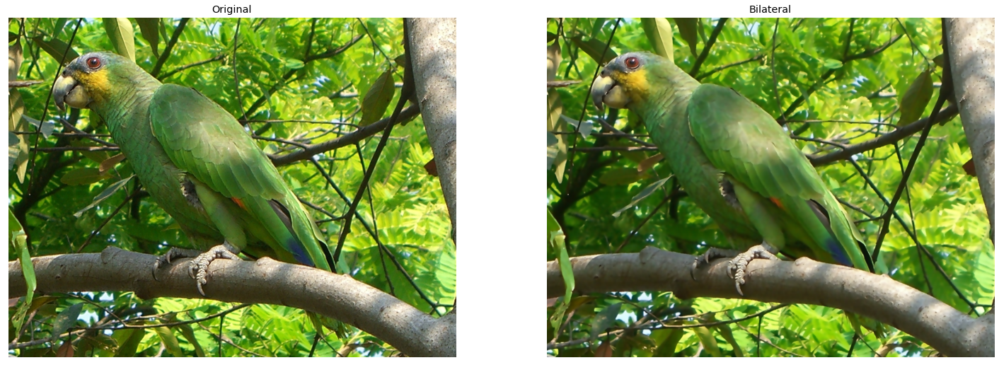

In [ ]:
# applying bilaterial filte
bilateral = cv2.bilateralFilter(img,9,75,75)
plt.gcf().set_size_inches(25,25)
plt.subplot(121),plt.imshow(img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(bilateral),plt.title('Bilateral')
plt.xticks([]), plt.yticks([])
plt.show()

### 3.5 Image Filtering Using Convolution

<b>2-D Convolution:</b> The fundamental and the most basic operation in image processing is convolution. This can be achieved by using Kernels. Kernel is a matrix that is generally smaller than the image and the center of the kernel matrix coincides with the pixels. In a 2D Convolution, the kernel matrix is a 2-dimensional, Square, A x B matrix, where both A and B are odd integers

<img src=https://media.geeksforgeeks.org/wp-content/uploads/20210917211659/conv.JPG width='400' height='400'></img>

The position of the output image is obtained by multiplying each value of the matrix with the corresponding value of the image matrix and then summing them up. Based on these operations performed, various effects like blurring and sharpening of the images can be performed.

<b>Identity Kernel:</b> Identity Kernel is the simplest and the most basic kernel operation that could be performed. The output image produced is exactly like the image that is given as the input. It does change the input image. It is a square matrix with the center element equal to 1. All the other elements of the matrix are 0. The code given below demonstrates the operation of Identity Kernel:

### <i>Demonstration</i>
For More Information Please Visit The Following Links:

https://www.geeksforgeeks.org/image-filtering-using-convolution-in-opencv/

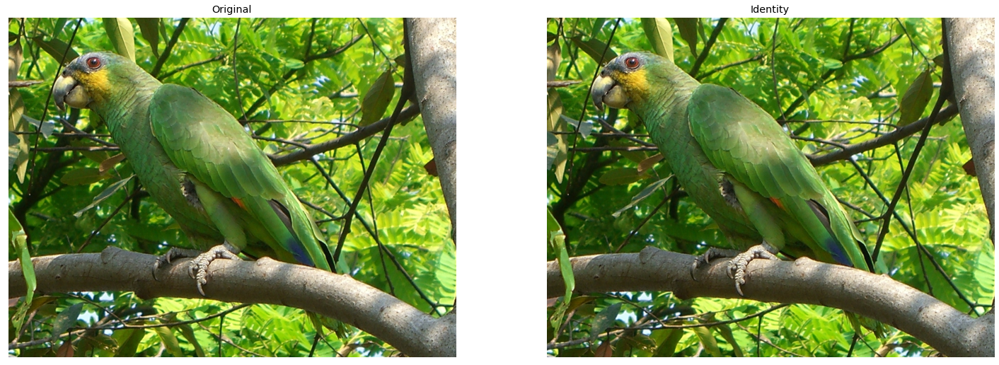

In [ ]:
# Apply identity kernel
# In an Identity Kernel matrix the value of the middle element is 1
# The values of all the other elements are 0
id_kernel = np.array([[0, 0, 0],
                    [0, 1, 0],
                    [0, 0, 0]])
# Filtered image is obtained using the variable flt_img
# cv2.fliter2D() is the function used
# src is the source of image(here, img)
# ddepth is destination depth. -1 will mean output image will have same depth as input image
# kernel is used for specifying the kernel operation (here, id_kernel)
flt_img = cv2.filter2D(src=img,ddepth=-1,kernel=id_kernel)
plt.gcf().set_size_inches(25,25)
plt.subplot(121),plt.imshow(img),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(flt_img),plt.title('Identity')
plt.xticks([]), plt.yticks([])
plt.show()

### 3.6 Other Kinds of Image Filters:

There are two more kinds of image filters:
1. Max Filter - enhances the bright pixels in the image
2. Min Filter - enhances the dark points in the image

The minimum filter erodes shapes on the image, whereas the maximum filter extends object boundaries.

In morphological filters, each pixel is updated based on comparing it against surrounding pixels in the running window. The running window is an image area around a current pixel with a defined radius. For example, if we specify the radius = 1, the running window will be a 3x3 square around the target pixel.

##### 1. The Minimum Filter
The transformation replaces the central pixel with the darkest one in the running window. For example, if you have text that is lightly printed, the minimum filter makes letters thicker.

##### 2. The Maximum Filter
The maximum and minimum filters are shift-invariant. Whereas the minimum filter replaces the central pixel with the darkest one in the running window, the maximum filter replaces it with the lightest one. For example, if you have a text string drawn with a thick pen, you can make the sign skinnier.

### <i>Demonstration</i>
For More Information Please Visit The Given Link:

https://www.graphicsmill.com/docs/gm/minimum-maximum-median-filters.htm#:~:text=The%20minimum%20filter%20erodes%20shapes,pixel%20with%20a%20defined%20radius.

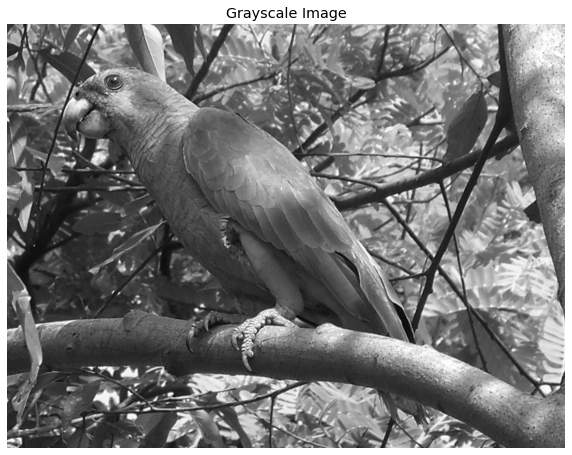

In [ ]:
gimg = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
plt.gcf().set_size_inches(10,10)
plt.title('Grayscale Image')
plt.imshow(gimg,cmap='gray')
plt.axis('off')
plt.show()

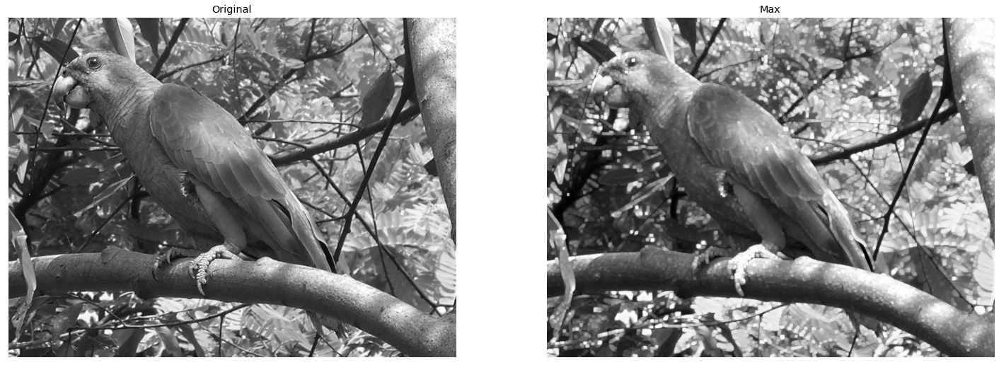

In [ ]:
# applying max filter
b = ndimage.filters.maximum_filter(gimg, size=5, footprint=None, output=None,
                                       mode='reflect', cval=0.0, origin=0)
plt.gcf().set_size_inches(25,25)
plt.subplot(121),plt.imshow(gimg,cmap='gray'),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(b,cmap='gray'),plt.title('Max')
plt.xticks([]), plt.yticks([])
plt.show()

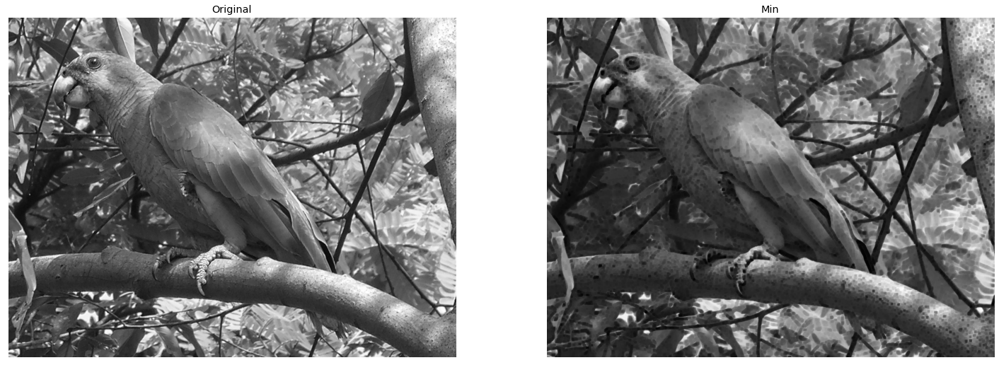

In [ ]:
# applying min filter
b = ndimage.filters.minimum_filter(gimg, size=5,
        footprint=None,output=None,mode='reflect',cval=0.0,
        origin=0)
plt.gcf().set_size_inches(25,25)
plt.subplot(121),plt.imshow(gimg,cmap='gray'),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(b,cmap='gray'),plt.title('Min')
plt.xticks([]), plt.yticks([])
plt.show()

## 4. Image Alignment

In many applications, we have two images of the same scene or the same document, but they are not aligned. In other words, if you pick a feature (say a corner) on one image, the coordinates of the same corner in the other image is very different.

Image alignment (also known as image registration) is the technique of warping one image ( or sometimes both images ) so that the features in the two images line up perfectly.

<img src=https://learnopencv.com/wp-content/uploads/2018/03/image-alignment-using-opencv.jpg width='400' height='400'></img>

### <i>Applications:</i>

Image alignment has numerous applications:

1. In many document processing applications, the first step is to align the scanned or photographed document to a template. For example, if you want to write an automatic form reader, it is a good idea to first align the form to its template and then read the fields based on a fixed location in the template.

2. In some medical applications, multiple scans of a tissue may be taken at slightly different times and the two images are registered using a combination of techniques. 

3. The most interesting application of image alignment is perhaps creating panoramas. In this case the two images are not that of a plane but that of a 3D scene. In general, 3D alignment requires depth information. However, when the two images are taken by rotating the camera about its optical axis (as in the case of panoramas). 

### <i>Image Alignment : Basic Theory</i>
At the heart of image alignment techniques is a simple 3×3 matrix called Homography. The Wikipedia entry for homography can look very scary.

Worry you should not because it’s my job to simplify difficult mathematical concepts like homography! I have explained homography in great detail with examples in this post. What follows is a shortened version of the explanation.

### <i>What is Homography?</i>
Two images of a scene are related by a homography under two conditions.

The two images are that of a plane (e.g. sheet of paper, credit card etc.).
The two images were acquired by rotating the camera about its optical axis. We take such images while generating panoramas.
As mentioned earlier, a homography is nothing but a 3×3 matrix as shown below.

<img src=https://learnopencv.com/wp-content/ql-cache/quicklatex.com-d11346122f20efb9f8535913f20fdfd1_l3.png width='400' height='400'></img>
 
Let (x1,y1) be a point in the first image and (x2,y2) be the coordinates of the same physical point in the second image. Then, the Homography H relates them in the following way

<img src=https://learnopencv.com/wp-content/ql-cache/quicklatex.com-c37a548be445fbbbdba716ff3cac7281_l3.png width='400' height='400'></img>
  
If we knew the homography, we could apply it to all the pixels of one image to obtain a warped image that is aligned with the second image.

### <i>How to find Homography?</i>

Homography example - marked four corresponding points in four different colors in both the images.

<img src=https://learnopencv.com/wp-content/uploads/2016/01/homography-example-768x511.jpg width='400' height='400'></img>

If we know 4 or more corresponding points in the two images, we can use the OpenCV function findHomography to find the homography. An example of four corresponding points is shown in the Figure above. The red, green, yellow and orange points are corresponding points.

Internally the function findHomography solves a linear system of equations to find the homography, but in this post we will not go over that math.

Let’s check the usage.

<b>h, status = cv2.findHomography(points1, points2)</b>

where, points1 and points2 are vectors/arrays of corresponding points, and h is the homography matrix.

### <i>How to find corresponding points automatically ?</i>

In many Computer Vision applications, we often need to identify interesting stable points in an image. These points are called keypoints or feature points. There are several keypoint detectors implemented in OpenCV ( e.g. SIFT, SURF, and ORB).

In this tutorial, we will use the ORB feature detector because it was co-invented by my former labmate Vincent Rabaud. Just kidding! We will use ORB because SIFT and SURF are patented and if you want to use it in a real-world application, you need to pay a licensing fee. ORB is fast, accurate and license-free!

ORB keypoints are shown in the image below using circles.

<img src=https://learnopencv.com/wp-content/uploads/2018/03/ORB-keypoints.png width='400' height='400'></img>

ORB stands for Oriented FAST and Rotated BRIEF. Let’s see what FAST and BRIEF mean.

A feature point detector has two parts

1. <b>Locator:</b> This identifies points on the image that are stable under image transformations like translation (shift), scale (increase / decrease in size), and rotation. The locator finds the x, y coordinates of such points. The locator used by the ORB detector is called FAST.

2. <b>Descriptor:</b> The locator in the above step only tells us where the interesting points are. The second part of the feature detector is the descriptor which encodes the appearance of the point so that we can tell one feature point from the other. The descriptor evaluated at a feature point is simply an array of numbers. Ideally, the same physical point in two images should have the same descriptor. ORB uses a modified version of the feature descriptor called BRISK.

Note: In many applications in Computer Vision, we solve a recognition problem in two steps — a) Localization 2) Recognition.

For example, for implementing a face recognition system, we first need a face detector that outputs the coordinate of a rectangle inside which a face is located. The detector does not know or care who the person is. Its only job is to locate a face.

The second part of the system is a recognition algorithm. The original image is cropped to the detected face rectangle, and this cropped image is fed to the face recognition algorithm which ultimately recognizes the person. The locator of the feature detector acts like a face detector. It localizes interesting points but does not deal with the identity of the point. The descriptor describes the region around the point so it can be identified again in a different image.

The homography that relates the two images can be calculated only if we know corresponding features in the two images. So a matching algorithm is used to find which features in one image match features in the other image. For this purpose, the descriptor of every feature in one image is compared to the descriptor of every feature in the second image to find good matches.

### <i>Steps for Feature Based Image Alignment</i>

Now we are in a position to summarize the steps involved in image alignment. The description below refers to the code in the next sections.

1. <b>Read Images:</b> We first read the reference image (or the template image) and the image we want to align to this template.

2. <b>Detect Features:</b> We then detect ORB features in the two images. Although we need only 4 features to compute the homography, typically hundreds of features are detected in the two images. We control the number of features using the parameter MAX_FEATURES in the Python code. 

3. <b>Match Features:</b> We find the matching features in the two images, sort them by goodness of match and keep only a small percentage of original matches. We finally display the good matches on the images and write the file to disk for visual inspection. We use the hamming distance as a measure of similarity between two feature descriptors. The matched features are shown in the figure below by drawing a line connecting them. Notice, we have many incorrect matches and thefore we will need to use a robust method to calculate homography in the next step. Image showing matched features connected by drawing corresponding lines. Figure 4. Matching keypoints are shown by drawing a line between them. Click to enlarge image. The matches are not perfect and therefore we need a robust method for calculating the homography in the next step.

<img src=https://learnopencv.com/wp-content/uploads/2018/03/keypoint-matching-1024x682.jpg width='400' height='400'></img>

4. <b>Calculate Homography:</b> A homography can be computed when we have 4 or more corresponding points in two images. Automatic feature matching explained in the previous section does not always produce 100% accurate matches. It is not uncommon for 20-30% of the matches to be incorrect. Fortunately, the findHomography method utilizes a robust estimation technique called Random Sample Consensus (RANSAC) which produces the right result even in the presence of large number of bad matches.

5. <b>Warping Image:</b> Once an accurate homography has been calculated, the transformation can be applied to all pixels in one image to map it to the other image. 

### <i>Demonstration</i>
For More Information Please Visit The Given Links:

https://pyimagesearch.com/2020/08/31/image-alignment-and-registration-with-opencv/

https://learnopencv.com/image-alignment-feature-based-using-opencv-c-python/

https://learnopencv.com/image-alignment-ecc-in-opencv-c-python/

In [ ]:
# Read Tempalate and Scanned Image

# Read reference image
refFilename = "form.jpg"
print("Reading reference image : ", refFilename)
im1 = cv2.imread(refFilename, cv2.IMREAD_COLOR)
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)

# Read image to be aligned
imFilename = "scanned-form.jpg"
print("Reading image to align : ", imFilename)
im2 = cv2.imread(imFilename, cv2.IMREAD_COLOR)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)

Reading reference image :  form.jpg
Reading image to align :  scanned-form.jpg


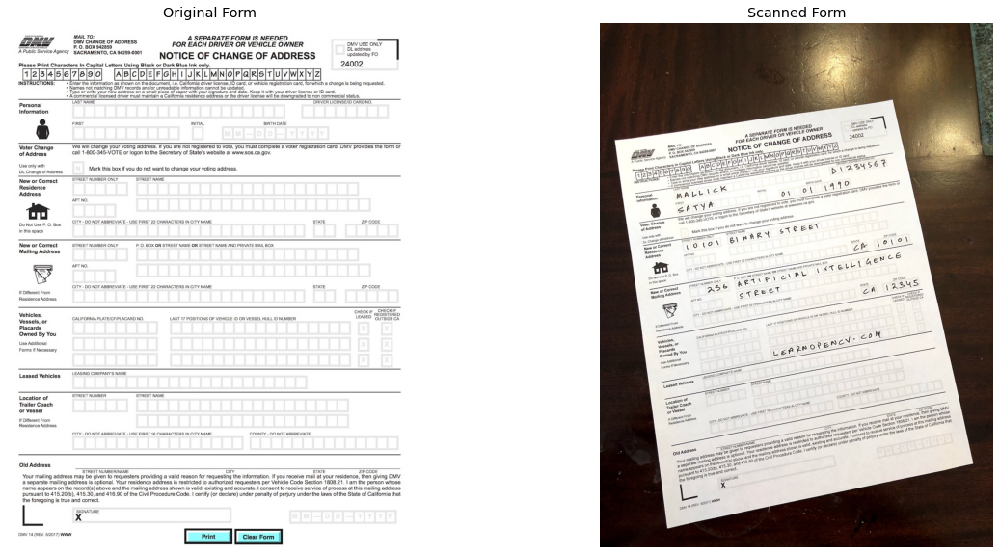

In [ ]:
# Display Images
plt.figure(figsize=[20,10]); 
plt.subplot(121); plt.axis('off'); plt.imshow(im1); plt.title("Original Form")
plt.subplot(122); plt.axis('off'); plt.imshow(im2); plt.title("Scanned Form")
plt.show()

In [ ]:
# Find keypoints in both Images

# Convert images to grayscale
im1_gray = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
im2_gray = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

# Detect ORB features and compute descriptors.
MAX_NUM_FEATURES = 500
orb = cv2.ORB_create(MAX_NUM_FEATURES)
keypoints1, descriptors1 = orb.detectAndCompute(im1_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(im2_gray, None)

# Display
im1_display = cv2.drawKeypoints(im1, keypoints1, outImage=np.array([]), color=(255, 0, 0), 
                                 flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im2_display = cv2.drawKeypoints(im2, keypoints2, outImage=np.array([]), color=(255, 0, 0), 
                                 flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

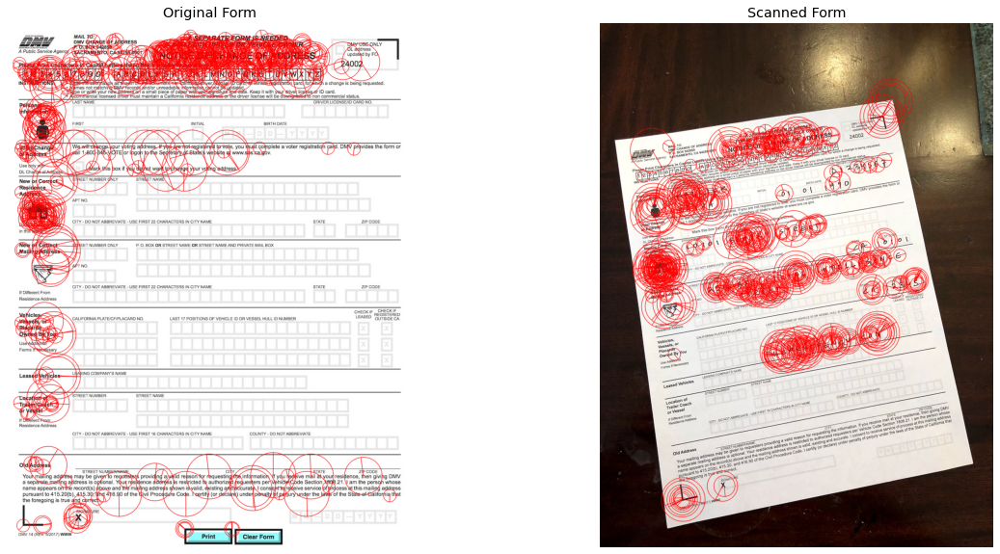

In [ ]:
plt.figure(figsize=[20,10])
plt.subplot(121); plt.axis('off'); plt.imshow(im1_display); plt.title("Original Form")
plt.subplot(122); plt.axis('off'); plt.imshow(im2_display); plt.title("Scanned Form")
plt.show()

In [ ]:
# Match keypoints in the two image

# Match features.
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
matches = list(matcher.match(descriptors1, descriptors2, None))

# Sort matches by score
matches.sort(key=lambda x: x.distance, reverse=False)

# Remove not so good matches
matches = tuple(matches)
numGoodMatches = int(len(matches) * 0.1)
matches = matches[:numGoodMatches]

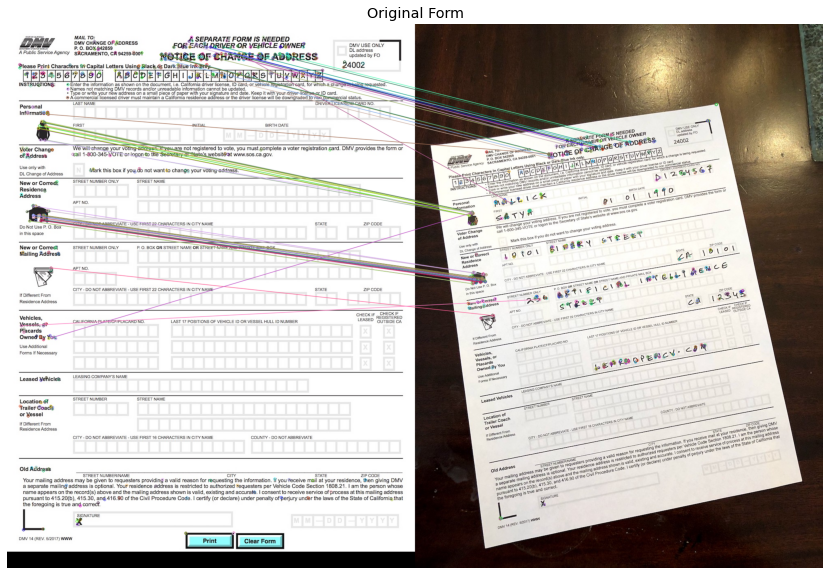

In [ ]:
# Draw top matches
im_matches = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)

plt.figure(figsize=[40,10])
plt.imshow(im_matches); plt.axis('off'); plt.title("Original Form");
plt.show()

In [ ]:
# Find Homography

# Extract location of good matches
points1 = np.zeros((len(matches),2),dtype=np.float32)
points2 = np.zeros((len(matches),2),dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = keypoints1[match.queryIdx].pt
    points2[i, :] = keypoints2[match.trainIdx].pt
  
# Find homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

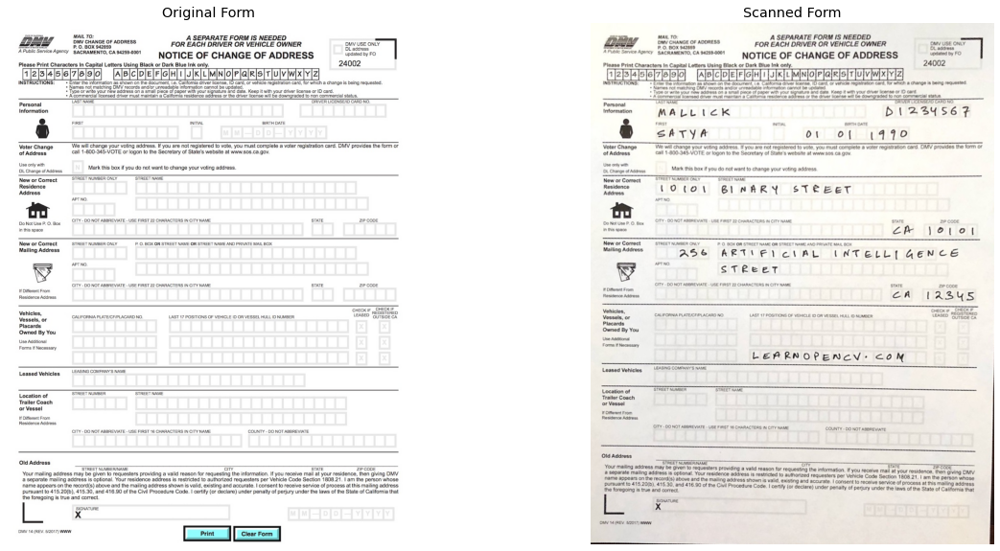

In [ ]:
# Warp Image

# Use homography to warp image
height, width, channel = im1.shape
im2_reg = cv2.warpPerspective(im2, h, (width,height))
# Display results
plt.figure(figsize=[20,10]); 
plt.subplot(121); plt.imshow(im1); plt.axis('off'); plt.title("Original Form");
plt.subplot(122); plt.imshow(im2_reg); plt.axis('off'); plt.title("Scanned Form");
plt.show()

## 5. Paranomas

Panorama is basically a photograph stretched horizontally without distortion.  

We will stitch 3 images together in today’s discussion to create our own panorama. To achieve this, the images must have some common key-points between images. In other words, a small portion from consecutive images must overlap otherwise images cannot be stitched together. Once we have the relevant images ready, we can simply use the stitch() function which belongs to the Stitcher class in the OpenCV module.  It takes an array of images as an argument and stitches them together. The function returns the resultant image and a bool value which is True if the stitching succeeds else it returns False.   

Resize the input images according to your need. If the images are way too large then scaling them down is always a better option. 

OpenCV’s stitching algorithm is similar to Lowe and Brown’s paper on Automatic Panoramic Image Stitching using Invariant Features. But here is the flowchart algorithm of opencv’s stitching class. 

<img src=https://media.geeksforgeeks.org/wp-content/uploads/20210927231154/1.png width='400' height='400'></img>

### <i>Explanation:</i>

The panorama stitching algorithm can be divided into four basic fundamental steps. These steps are as follows:

1. Detection of keypoints (points on the image) and extraction of local invariant descriptors (SIFT feature) from input images.
2. Finding matched descriptors between the input images.
3. Calculating the homography matrix using the RANSAC algorithm.
4. The homography matrix is then applied to the image to wrap and fit those images and merge them into one.

Descriptors are vectors that describe the local surroundings around a specific keypoint.  

Keypoints are found by calculating the difference of Gaussian blur of the image at different levels. That means the image is blurred with a gaussian blur at different magnitudes, from slightly blurred to more blurred and so on. Then those images are subtracted from each other resulting in the difference of images with different levels of Gaussian blurs. The resultant images are stacked upon each other to look for extreme points which are locally distinct, those are keypoints. 

Descriptors are computed by looking at the neighborhood of the keypoint, breaking down the local neighborhood into small areas, and then computing the gradient in these small areas. These gradients are collected in the form of histograms. Basically, how often those gradients occur and their magnitude are turned into histograms for small local regions. Finally, concatenating all the values computed from the histogram will result in the descriptor vector. This as a whole is known as SIFT feature, which is nothing but a way for computing keypoints and descriptors.

Coming to the homography matrix, it maps the corresponding points of one image to another. This is essential in creating the panorama. It is necessary to compute the homography of two images as it helps to wrap one image onto the other, which is useful for creating panoramas. RANSAC algorithm helps to compute this homography matrix.

The actual stitching is done by the .stitch() function or method of the stitcher class. It implements the above steps. This function comes with the latest version of OpenCV. Stitch() function accepts a list of images as a parameter. It returns a tuple (status, output), where status is a bool value and it True when the stitching is done successfully else false. Output is the resultant panorama.  

### <i>Demonstration</i>
For More Information Please Visit The Given Links:

https://pyimagesearch.com/2016/01/11/opencv-panorama-stitching/

https://towardsdatascience.com/image-panorama-stitching-with-opencv-2402bde6b46c

https://www.geeksforgeeks.org/opencv-panorama-stitching/

https://docs.opencv.org/4.x/d8/d19/tutorial_stitcher.html

In [ ]:
import glob
import math

In [ ]:
# Read Images
imagefiles = glob.glob("boat/*")
imagefiles.sort()
images = []
for filename in imagefiles:
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append(img)
num_images = len(images)

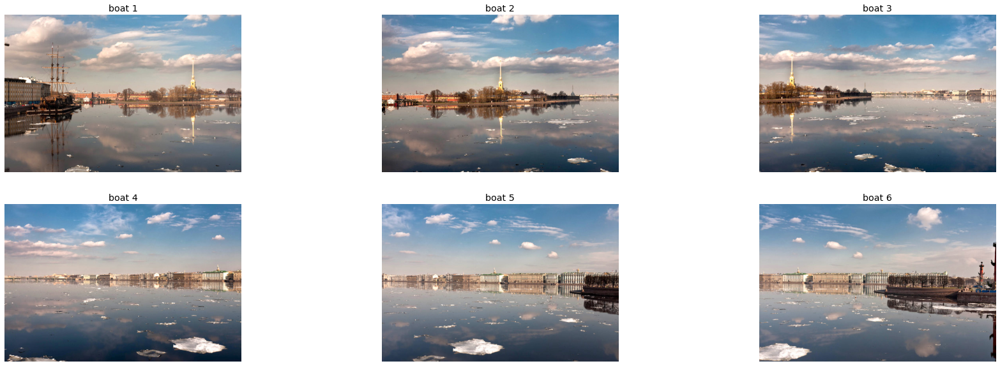

In [ ]:
# Display Images
plt.figure(figsize=[30,10]) 
num_cols = 3
num_rows = math.ceil(num_images / num_cols)
for i in range(0, num_images):
    plt.subplot(num_rows, num_cols, i+1) 
    plt.title('boat '+str(i+1))
    plt.axis('off')
    plt.imshow(images[i])

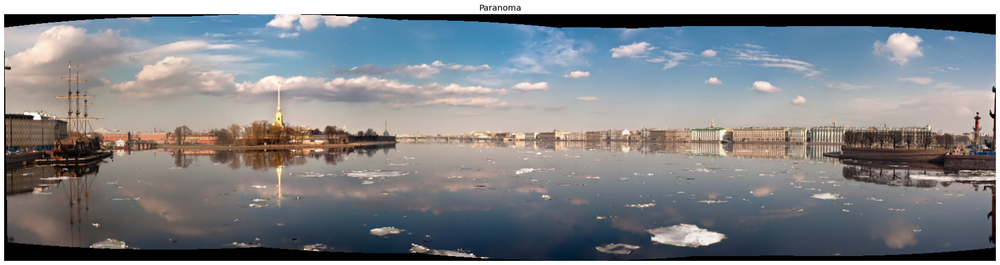

In [ ]:
# Stich Image
stitcher = cv2.Stitcher_create()
status, result = stitcher.stitch(images)
if (status == 0):
    plt.figure(figsize=[30,10]) 
    plt.imshow(result)
    plt.axis('off')
plt.title('Paranoma')
plt.show()

## 6. High Dynamic Range (HDR) Imaging

High-dynamic-range imaging (HDRI or HDR) is a technique used in imaging and photography to reproduce a greater dynamic range of luminosity than is possible with standard digital imaging or photographic techniques. While the human eye can adjust to a wide range of light conditions, most imaging devices use 8-bits per channel, so we are limited to only 256 levels. When we take photographs of a real world scene, bright regions may be overexposed, while the dark ones may be underexposed, so we can’t capture all details using a single exposure. HDR imaging works with images that use more than 8 bits per channel (usually 32-bit float values), allowing much wider dynamic range.

There are different ways to obtain HDR images, but the most common one is to use photographs of the scene taken with different exposure values. To combine these exposures it is useful to know your camera’s response function and there are algorithms to estimate it. After the HDR image has been merged, it has to be converted back to 8-bit to view it on usual displays. This process is called tonemapping. Additional complexities arise when objects of the scene or camera move between shots, since images with different exposures should be registered and aligned.

In this section we show 2 algorithms (Debevec, Robertson) to generate and display HDR image from an exposure sequence, and demonstrate an alternative approach called exposure fusion (Mertens), that produces low dynamic range image and does not need the exposure times data. Furthermore, we estimate the camera response function (CRF) which is of great value for many computer vision algorithms. Each step of HDR pipeline can be implemented using different algorithms and parameters, so take a look at the reference manual to see them all.

<img src=https://docs.opencv.org/3.4/exposures.jpg width='400' height='400'></img>

### <i>Exposure sequence HDR</i> 

In this section we will look on the following scene, where we have 4 exposure images, with exposure times of: 15, 2.5, 1/4 and 1/30 seconds. (You can download the images from Wikipedia)

Steps:

1. <b>Loading exposure images into a list</b>
The first stage is simply loading all images into a list. In addition, we will need the exposure times for the regular HDR algorithms. Pay attention for the data types, as the images should be 1-channel or 3-channels 8-bit (np.uint8) and the exposure times need to be float32 and in seconds.

2. <b>Merge exposures into HDR image</b>
In this stage we merge the exposure sequence into one HDR image, showing 2 possibilities which we have in OpenCV. The first method is Debevec and the second one is Robertson. Notice that the HDR image is of type float32, and not uint8, as it contains the full dynamic range of all exposure images.

3. <b>Tonemap HDR image</b>
We map the 32-bit float HDR data into the range [0..1]. Actually, in some cases the values can be larger than 1 or lower the 0, so notice we will later have to clip the data in order to avoid overflow.

4. <b>Merge exposures using Mertens fusion</b>
Here we show an alternative algorithm to merge the exposure images, where we do not need the exposure times. We also do not need to use any tonemap algorithm because the Mertens algorithm already gives us the result in the range of [0..1].

5. <b>Convert to 8-bit and save</b>
In order to save or display the results, we need to convert the data into 8-bit integers in the range of [0..255].


### <i>Demonstration</i>
For More Information Please Visit The Given Links:

https://docs.opencv.org/4.x/d3/db7/tutorial_hdr_imaging.html

https://docs.opencv.org/3.4/d2/df0/tutorial_py_hdr.html

https://medium.datadriveninvestor.com/hdr-imaging-what-how-to-generate-2d0a25ad262e

https://learnopencv.com/high-dynamic-range-hdr-imaging-using-opencv-cpp-python/

https://towardsdatascience.com/a-simple-hdr-implementation-on-opencv-python-2325dbd9c650

In [ ]:
# Capture Multiple Exposures

def readImagesAndTimes():
    # List of file names
    filenames = ["img_0.033.jpg", "img_0.25.jpg", "img_2.5.jpg", "img_15.jpg"]
    # List of exposure times
    times = np.array([ 1/30.0, 0.25, 2.5, 15.0 ], dtype=np.float32)
    # read images
    images = []
    for filename in filenames:
        im = cv2.imread(filename)
        im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
        images.append(im)
    return images, times

In [ ]:
# Align Images

# Read images and exposure times
images, times = readImagesAndTimes()

# Align Images
alignMTB = cv2.createAlignMTB()
alignMTB.process(images, images)

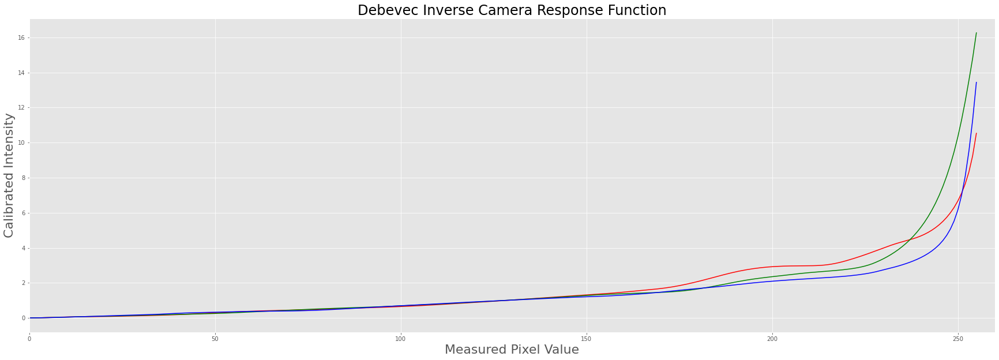

In [ ]:
# Estimate Camera Response Function

# Find Camera Response Function (CRF)
calibrateDebevec = cv2.createCalibrateDebevec()
responseDebevec = calibrateDebevec.process(images, times)

# Plot CRF
x = np.arange(256, dtype=np.uint8)
y = np.squeeze(responseDebevec)

ax = plt.figure(figsize=(30,10))
plt.title("Debevec Inverse Camera Response Function", fontsize=24)
plt.xlabel("Measured Pixel Value", fontsize=22)
plt.ylabel("Calibrated Intensity", fontsize=22)
plt.xlim([0,260])
plt.grid(True)
plt.plot(x, y[:,0],'r'  , x, y[:,1],'g', x, y[:,2],'b');
plt.show()

In [ ]:
# Merge Exposure into an HDR Image

# Merge images into an HDR linear image
mergeDebevec = cv2.createMergeDebevec()
hdrDebevec = mergeDebevec.process(images, times, responseDebevec)

saved ldr-Drago.jpg


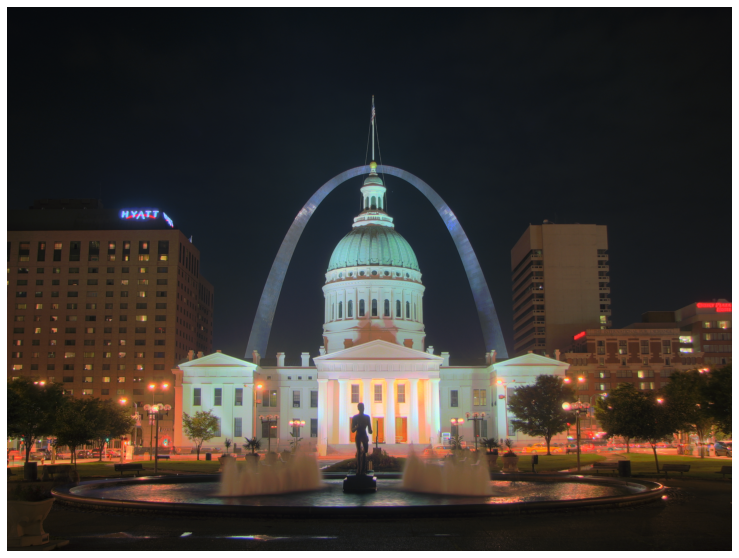

In [ ]:
# Tonemapping

# Tonemap using Drago's method to obtain 24-bit color image
tonemapDrago = cv2.createTonemapDrago(1.0, 0.7)
ldrDrago = tonemapDrago.process(hdrDebevec)
ldrDrago = 3 * ldrDrago
plt.figure(figsize=(20,10)); plt.imshow(np.clip(ldrDrago,0,1)); plt.axis('off');
cv2.imwrite("ldr-Drago.jpg", ldrDrago * 255)
print("saved ldr-Drago.jpg")

Tonemaping using Reinhard's method ... 
saved ldr-Reinhard.jpg


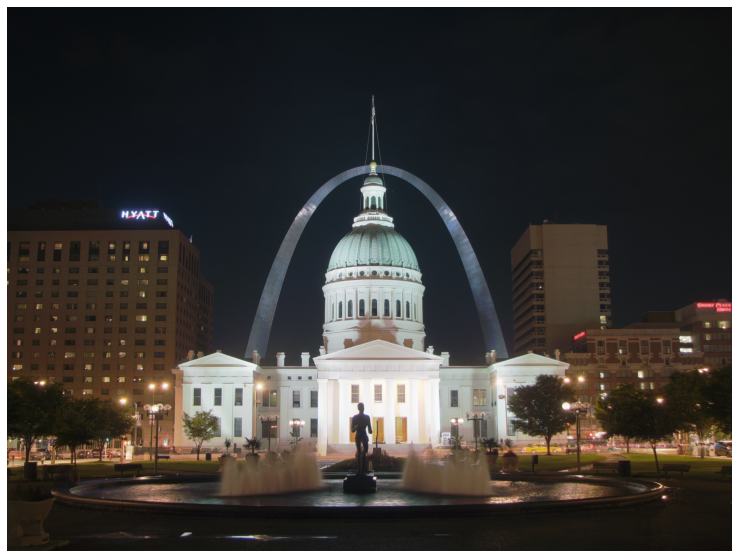

In [ ]:
# Tonemap using Reinhard's method to obtain 24-bit color image
print("Tonemaping using Reinhard's method ... ")
tonemapReinhard = cv2.createTonemapReinhard(1.5, 0,0,0)
ldrReinhard = tonemapReinhard.process(hdrDebevec)
plt.figure(figsize=(20,10)); plt.imshow(np.clip(ldrReinhard,0,1)); plt.axis('off');
cv2.imwrite("ldr-Reinhard.jpg", ldrReinhard * 255)
print("saved ldr-Reinhard.jpg")

Tonemaping using Mantiuk's method ... 
saved ldr-Mantiuk.jpg


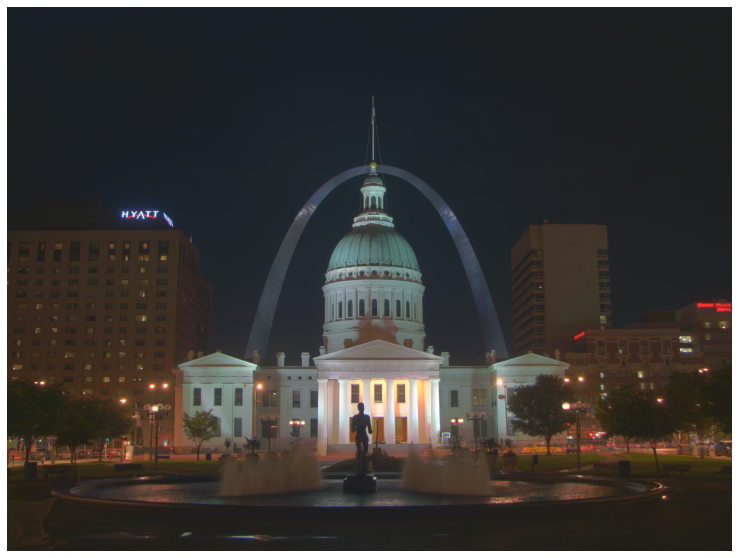

In [ ]:
# Tonemap using Mantiuk's method to obtain 24-bit color image
print("Tonemaping using Mantiuk's method ... ")
tonemapMantiuk = cv2.createTonemapMantiuk(2.2,0.85, 1.2)
ldrMantiuk = tonemapMantiuk.process(hdrDebevec)
ldrMantiuk = 3 * ldrMantiuk
plt.figure(figsize=(20,10)); plt.imshow(np.clip(ldrMantiuk,0,1)); plt.axis('off');
cv2.imwrite("ldr-Mantiuk.jpg", ldrMantiuk * 255)
print("saved ldr-Mantiuk.jpg")

# The End of Chapter 2 !!!